## Dataset Used : 
- Life Expectancy (WHO) :
    - Statistical Analysis on factors influencing Life Expectancy <br>
    
<i> kaggle datasets download -d kumarajarshi/life-expectancy-who </i> <br>

<i> https://www.kaggle.com/kumarajarshi/life-expectancy-who </i>

<b> Context </b> <br>
Although there have been lot of studies undertaken in the past on factors affecting life expectancy considering demographic variables, income composition and mortality rates. It was found that affect of immunization and human development index was not taken into account in the past. Also, some of the past research was done considering multiple linear regression based on data set of one year for all the countries. Hence, this gives motivation to resolve both the factors stated previously by formulating a regression model based on mixed effects model and multiple linear regression while considering data from a period of 2000 to 2015 for all the countries. Important immunization like Hepatitis B, Polio and Diphtheria will also be considered. In a nutshell, this study will focus on immunization factors, mortality factors, economic factors, social factors and other health related factors as well. Since the observations this dataset are based on different countries, it will be easier for a country to determine the predicting factor which is contributing to lower value of life expectancy. This will help in suggesting a country which area should be given importance in order to efficiently improve the life expectancy of its population.

<b> Content </b> <br>
The project relies on accuracy of data. The Global Health Observatory (GHO) data repository under World Health Organization (WHO) keeps track of the health status as well as many other related factors for all countries The data-sets are made available to public for the purpose of health data analysis. The data-set related to life expectancy, health factors for 193 countries has been collected from the same WHO data repository website and its corresponding economic data was collected from United Nation website. Among all categories of health-related factors only those critical factors were chosen which are more representative. It has been observed that in the past 15 years , there has been a huge development in health sector resulting in improvement of human mortality rates especially in the developing nations in comparison to the past 30 years. Therefore, in this project we have considered data from year 2000-2015 for 193 countries for further analysis. The individual data files have been merged together into a single data-set. On initial visual inspection of the data showed some missing values. As the data-sets were from WHO, we found no evident errors. Missing data was handled in R software by using Missmap command. The result indicated that most of the missing data was for population, Hepatitis B and GDP. The missing data were from less known countries like Vanuatu, Tonga, Togo, Cabo Verde etc. Finding all data for these countries was difficult and hence, it was decided that we exclude these countries from the final model data-set. The final merged file(final dataset) consists of 22 Columns and 2938 rows which meant 20 predicting variables. All predicting variables was then divided into several broad categories:​Immunization related factors, Mortality factors, Economical factors and Social factors.




## Objective : 
#### Use regression models in order to predict life expectancy.
    - Interpretation is more important than prediction in this context given we want to know which factors are the most impacting the life expectancy of a population

###  1) Data cleaning and exploration. 

In [1]:
#imports 
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import matplotlib
import matplotlib.pyplot as plt

matplotlib.rcParams['figure.figsize'] = (15,7)

In [4]:
df = pd.read_csv('./data/Life_Expectancy_Data.csv')
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
df.drop(['Population'], axis = 1, inplace = True) # too many NaN values and errors
df.reset_index()
df.shape

(2938, 21)

2938 entries with 21 features. <br>
Since columns names are non consistent, we'll rename them properly by removing uppder cases, replacing inside spaces by _ and removing begin/end spaces 

In [7]:
from helper import columns_name_correcter
new_cols = columns_name_correcter(df.columns)

df.rename(axis = 1, mapper = dict(zip(df.columns.values, new_cols)), inplace = True)
pd.DataFrame(df.columns).head(5)

,0
0,country
1,year
2,status
3,life_expectancy
4,adult_mortality


In [8]:
from helper import outliers_by_country, remove_NaN_values
outliers, outliers_solved = outliers_by_country(df)
nan_removed = remove_NaN_values(df)

In [10]:
df.head(6)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,under_five_deaths,polio,total_expenditure,diphtheria,hiv/aids,gdp,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,83,6.0,8.16,65.0,0.1,584.259210,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,86,58.0,8.18,62.0,0.1,612.696514,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,89,62.0,8.13,64.0,0.1,631.744976,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,93,67.0,8.52,67.0,0.1,669.959000,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,97,68.0,7.87,68.0,0.1,63.537231,18.2,18.2,0.454,9.5
5,Afghanistan,2010,Developing,58.8,279.0,74,0.01,79.679367,66.0,1989,...,102,66.0,9.20,66.0,0.1,553.328940,18.4,18.4,0.448,9.2


In [13]:
df_resume = pd.DataFrame([df.dtypes, df.isnull().sum(), outliers.count(axis=0)]).rename({1: 'null_values', 0:'dtypes', 2:"outliers"}, axis = 0)
df_resume.drop(['country','year', 'status', 'life_expectancy'], axis = 1)

,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,under_five_deaths,polio,total_expenditure,diphtheria,hiv/aids,gdp,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
dtypes,float64,int64,float64,float64,float64,int64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64
null_values,10,0,194,0,553,0,34,0,19,226,19,0,448,34,34,167,163
outliers,330,25,196,609,178,769,280,33,173,66,161,123,451,54,55,22,9


In [14]:
df.update(outliers_solved)
df.update(nan_removed)

In [15]:
df.head(6)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,under_five_deaths,polio,total_expenditure,diphtheria,hiv/aids,gdp,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,83,54.5,8.16,65.0,0.1,584.25921,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,1919.454545,...,86,58.0,8.18,62.0,0.1,612.696514,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,1919.454545,...,89,62.0,8.13,64.0,0.1,631.744976,17.7,17.7,0.47,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,93,67.0,8.52,67.0,0.1,669.959,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,39.348286,68.0,3013,...,97,68.0,7.87,68.0,0.1,382.24396,18.2,18.2,0.454,9.5
5,Afghanistan,2010,Developing,58.8,279.0,74,0.01,79.679367,66.0,1989,...,102,66.0,9.2,66.0,0.1,553.32894,18.4,18.4,0.448,9.2


In [18]:
#removing rows where life expectancy is null (used to be NaN):
mask_life_zero = df[df['life_expectancy'] ==0].index
df.drop(mask_life_zero, inplace = True )

Encode the 'status' feature so it can be used in regressions.
'status' can only take 'developped' or 'developping' values. Instead of using sklearn libraries, we'll just do a quick mapping of the column, since there's only 2 values and 1 column to encode. 

In [19]:
df['status'].value_counts()

Developing    2416
Developed      512
Name: status, dtype: int64

In [20]:
df['status'] = df['status'].map({'Developing':0, 'Developed':1})
df['status'].value_counts()

0    2416
1     512
Name: status, dtype: int64

In [21]:
for col in df.columns.drop(['country']):
    df[col] = df[col].astype(float)

We now only have numerical features, which is great since we can use them for training regression models. However, we have to make sure that our residuals are not too skewed, in order to checks this we'll use both panda .skew() method and plot the histograms of our target feature : 'life_expectancy'

<AxesSubplot:title={'center':'target feature skew :-0.6310077882021724'}, ylabel='Frequency'>

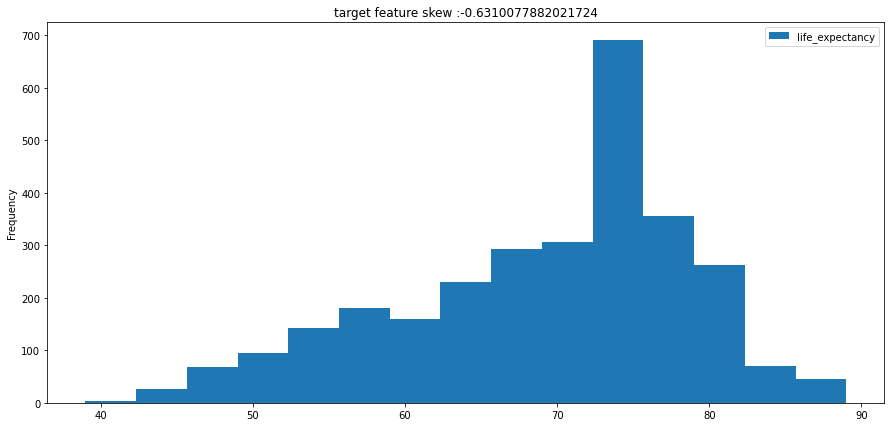

In [22]:
df['life_expectancy'].plot(kind = 'hist', bins = 15,
                           title = f'target feature skew :{df["life_expectancy"].skew()}',
                           legend = True)

It appears that our data is lightly skewed to the left. let's try using the box-cox transform on it.

<AxesSubplot:title={'center':'target feature skew :-0.10656396772239371'}, ylabel='Frequency'>

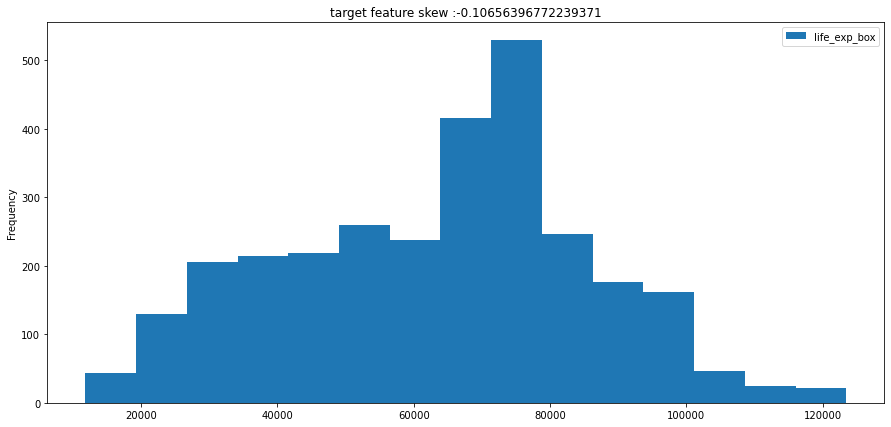

In [23]:
from scipy.stats import boxcox

df['life_exp_box'] = boxcox(df['life_expectancy'].to_numpy())[0] 

df['life_exp_box'].plot(kind = 'hist', bins = 15,
                           title = f'target feature skew :{df["life_exp_box"].skew()}',
                           legend = True)

Our target varaible is now almost normally distributed.

We can take a look to correlations between features and our target using heatmap from seaborn : 

<AxesSubplot:>

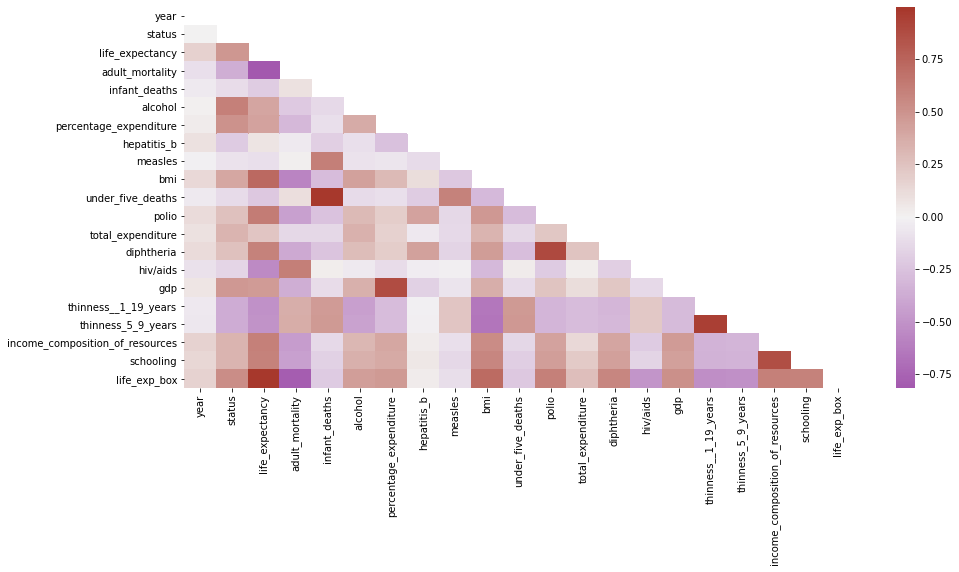

In [24]:
import seaborn as sns

corr_matrix = df.corr()
mask = np.triu(np.ones_like(corr_matrix, dtype = bool)) #preparing the mask to keep only half of the matrix
cmap = sns.diverging_palette(300, 15, s=75, l=40,
                             n=9, center="light", as_cmap=True)

sns.heatmap(corr_matrix, mask = mask, center = 0, annot = False, cmap = cmap)


#### Preparaing data for regression

Since we now only have numerical features, there is no need for one hot encoding. We'll split the main dataframe in features and target and perform a basic linear regression on this.

In [25]:
X = df.drop(['life_expectancy', 'country', 'life_exp_box', 'year'], axis = 1)
y = df['life_exp_box']

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

In [27]:
lreg = LinearRegression()
lreg.fit(X_train, y_train)

y_pred = lreg.predict(X_test)

print(f'MSE obtained with a basic linear regression : {mean_squared_error(y_pred, y_test)}')

MSE obtained with a basic linear regression : 79699215.04122418


C:\Users\Tommy\.conda\envs\My-Env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


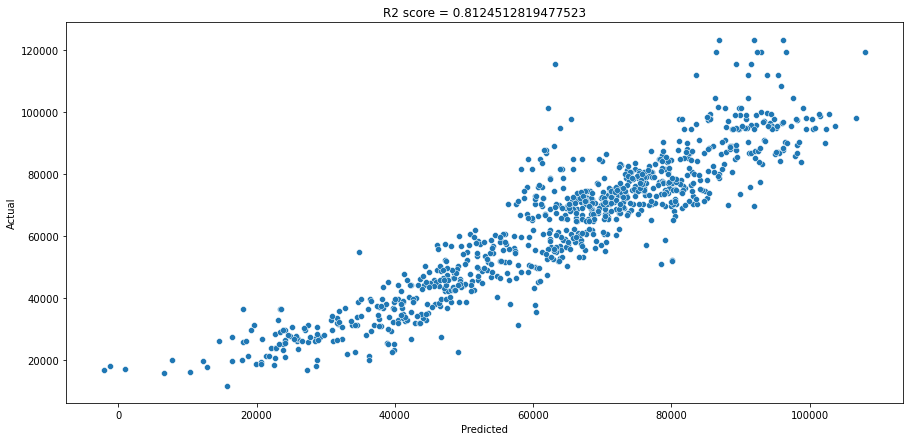

In [28]:
#let's plot predicted VS validation data
from helper import plotRegression
plotRegression(y_pred, y_test)

The variance seems to be quite high, but the trend is decent. 

Let's now implement polynomial features while still using basic regression

In [29]:
from sklearn.preprocessing import PolynomialFeatures

polyfeat = PolynomialFeatures(degree = 2, include_bias = False)
X_poly = polyfeat.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_poly, y)

C:\Users\Tommy\.conda\envs\My-Env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


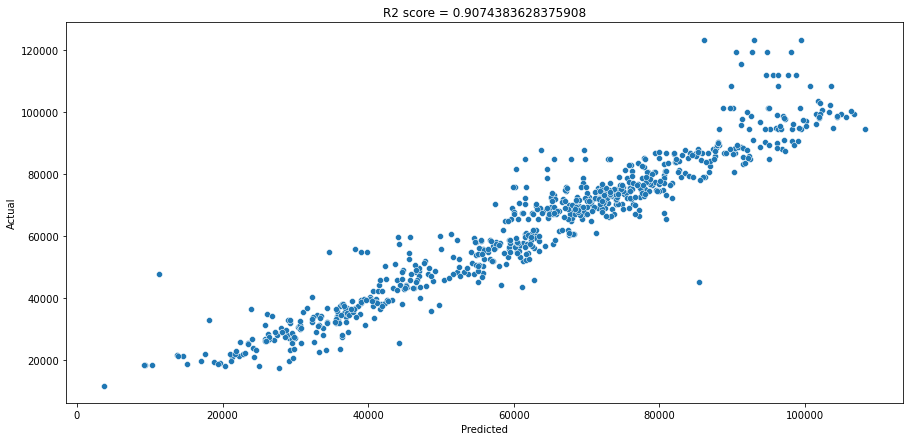

In [30]:
lr = LinearRegression()
lr.fit(X_train, y_train)
y_pred_poly = lr.predict(X_test)

plotRegression(y_pred_poly, y_test)

By adding more features, we reduced the variance of our model and therefore greatly increased it's quality.

#### Lasso model building to aim for a high interpredtability

As mentionned earlier, the main goal here is interpretability in order to have the best possible understanding of which factors impact the most the life expectancy.

In [31]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

In [32]:
#lets firt add polynomial features.
polyfeat = PolynomialFeatures(degree = 2, include_bias = False)
polyfeat.fit(X)
X_poly = polyfeat.transform(X)

In [33]:
X_poly = pd.DataFrame(X_poly, columns = polyfeat.get_feature_names(input_features = X.columns.values))

In [34]:
# scaling data for Lasso regression
scaler = StandardScaler()
Xscaled = scaler.fit_transform(X_poly)

In [35]:
import warnings
warnings.simplefilter('ignore')

In [36]:
alphas = [0.01, 0.1, 1, 10, 100, 150]
lasso = Lasso(max_iter = 10000)

grid = GridSearchCV(estimator = lasso,
                   param_grid = {'alpha':alphas},
                   scoring = 'r2',
                   cv = 5,
                   )
grid.fit(Xscaled, y)
alpha = grid.best_params_
score = grid.best_score_

print(f'best r2 score obtained : {score} for alpha = {alpha}')

best r2 score obtained : 0.8683065591851042 for alpha = {'alpha': 100}


Better than our first linear regression, but slightly lower than the linear regression with all of the polynomial features.

In [31]:
alpha = 100
best_lasso = Lasso(alpha = alpha, max_iter = 10000)
best_lasso.fit(Xscaled, y)

Lasso(alpha=100, max_iter=10000)

In [32]:
#lasso_coefs = pd.DataFrame([X_poly.columns, best_lasso.coef_], columns = X_poly.columns)
lasso_coefs = pd.DataFrame(best_lasso.coef_, index = X_poly.columns).sort_values(by=0).reset_index().rename({'index':'feature', 0:'coef'}, axis = 1)
#lasso_coefs.sort_values(by = 'coef', ascending = False)
#lasso_coefs.drop(0, axis = 0, inplace = True)

lasso_coefs

,feature,coef
0,hiv/aids,-6030.941269
1,adult_mortality polio,-5387.404951
2,alcohol income_composition_of_resources,-5053.195924
3,diphtheria income_composition_of_resources,-4201.108388
4,polio income_composition_of_resources,-4071.684578
...,...,...
184,alcohol diphtheria,3286.511503
185,polio,4614.540135
186,alcohol,4645.193622
187,adult_mortality hiv/aids,6066.100082


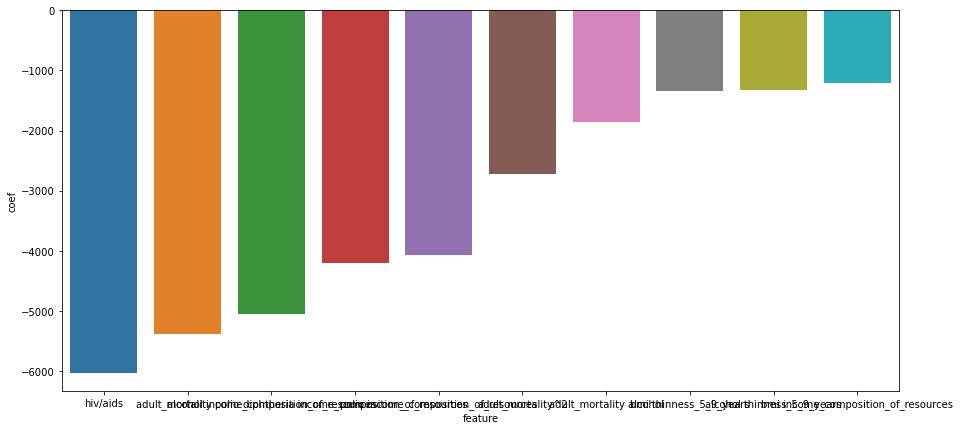

In [37]:
from helper import plot_hightest_coefs

plot_highest_coefs(lasso_coefs, 6)

In [ ]:
plot_highest_coefs(lasso_coefs, -6)